## Artist trajectory network

##### Imports

In [19]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import requests
import json
import locale
from graph_tool.all import *
from datetime import datetime
from bs4 import BeautifulSoup
from collections import Counter
import seaborn as sns
import matplotlib
import sklearn.cluster
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import set_link_color_palette as dendrogram_colours
locale.setlocale(locale.LC_TIME, 'en_US.UTF-8');

### Data preparation

First, making fuctions to identify different types of institutions. Here I distinguish betweeen museums (also arthalls, houses of culture and so on), galleries (the main point i sthat the y sell art instead of just exhibiting it, so they are commercial), journals (any kind of media, there are a lot of announcements about art criticism), festivals (time-based ecents like biennials and art festivals), education institutions, and centres (very general category, could be almost anything). Unfortunately, since the categorisation is quite basic, there are a lot of institutions out of range. I still save the names of the most prominent ones as exceptions in each function. We could not have come up with a good scrapping solution for this, and I am quite sure there are no quite good ones.

In [20]:
def filt_mus(x):
    '''
    Return TRUE if string looks like a museum institution title
    '''
    list_insts = ['Secession', 'Portikus', 'ZKM | Center for Art and Media Karlsruhe', 'Walker Art Center',
                 'S.M.A.K.', 'Tate Modern', 'Para Site', 'Palais de Tokyo']
    # ^- manually selected full titles
    # v- parts of the title to search for
    list_langs = ['mus', 'verein', 'kunsthall', 'guggenheim', 'haus', 'konsthall', 'fond', 'found', 'fund']
    if x in list_insts:
        return True
    try:
        res = 0
        for lang in list_langs:
            res += int(lang in x.lower())
        return res>0
    except AttributeError:
        return False

def filt_gall(x):
    '''
    Return TRUE if string looks like a gallery institution title
    '''
    list_insts = ['Zilberman', 'Serpentine']
    # ^- manually selected full titles
    # v- parts of the title to search for
    list_langs = ['gall', 'gale']
    if x in list_insts:
        return True
    try:
        res = 0
        for lang in list_langs:
            res += int(lang in x.lower())
        return res>0
    except AttributeError:
        return False

def filt_educ(x):
    '''
    Return TRUE if string looks like a educational institution title
    '''
    list_insts = []
    # ^- manually selected full titles
    # v- parts of the title to search for
    list_langs = ['unive', 'institu', 'school', 'college', 'educ', 'academ']
    if x in list_insts:
        return True
    try:
        res = 0
        for lang in list_langs:
            res += int(lang in x.lower())
        return res>0
    except AttributeError:
        return False

def filt_jour(x):
    '''
    Return TRUE if string looks like a publishing institution title
    '''
    list_insts = ['e-flux', 'Artforum', 'Flash Art International',
                  'frieze', 'ArtAsiaPacific', 'Frieze']
    # ^- manually selected full titles
    # v- parts of the title to search for
    list_langs = ['journ', 'magazi', 'press']
    if x in list_insts:
        return True
    try:
        res = 0
        for lang in list_langs:
            res += int(lang in x.lower())
        return res>0
    except AttributeError:
        return False

def filt_fest(x):
    '''
    Return TRUE if string looks like a time-based event title
    '''
    list_insts = []
    # ^- manually selected full titles
    # v- parts of the title to search for
    list_langs = ['bien', 'festiv']
    if x in list_insts:
        return True
    try:
        res = 0
        for lang in list_langs:
            res += int(lang in x.lower())
        return res>0
    except AttributeError:
        return False

def filt_cent(x):
    '''
    Return TRUE if string looks like a centre institution title
    '''
    list_insts = []
    # ^- manually selected full titles
    # v- parts of the title to search for
    list_langs = ['centr', 'center']
    if x in list_insts:
        return True
    try:
        res = 0
        for lang in list_langs:
            res += int(lang in x.lower())
        return res>0
    except AttributeError:
        return False

def filt_all(x):
    '''
    Check if the previous fuctions could identify 1 and only 1 type for a string
    '''
    return filt_mus(x)+filt_gall(x)+filt_educ(x)+filt_jour(x)+filt_fest(x)+filt_cent(x) == 1
    

Open data, create a dataframe to store the nodes (institutions) and assign them a type. If something goes wrong — the place is attributed either to other (no match) or to error (more than one matches). 

In [21]:
#       loading the file
with open('data/announcements.json') as file:
    anns = json.load(file)
#       adding the id inside the announcement dict
for id in anns.keys():
    anns[id]['id'] = id
#       creating a dataframe with announcements
anns_list = [value for value in anns.values()]
df = pd.json_normalize(anns_list)
df.set_index('id', inplace=True)
df.drop('title_artists', inplace=True, axis=1)
df.dropna(inplace=True)
df['date'] = df.announcement_date.apply(lambda x: datetime.strptime(x, '%B %d, %Y'))
#       creating nodes series — unique subtitles which are locations i.e. venue titles
nodes = df.subtitle.value_counts()
#       creating a dataframe and checking the type of institution
df_nodes = pd.DataFrame(nodes)
df_nodes['title'] = df_nodes.index
df_nodes['museum'] = df_nodes.title.apply(filt_mus)
df_nodes['gallery'] = df_nodes.title.apply(filt_gall)
df_nodes['education'] = df_nodes.title.apply(filt_educ)
df_nodes['journal'] = df_nodes.title.apply(filt_jour)
df_nodes['festival'] = df_nodes.title.apply(filt_fest)
df_nodes['center'] = df_nodes.title.apply(filt_cent)
df_nodes['categorised'] = df_nodes.title.apply(filt_all)
df_nodes['title'] = np.zeros(len(df_nodes))
#       filtering out all errors (2 or more types) and blanks (no type)
for title in df_nodes.index:
    if sum(df_nodes.loc[title, 'museum':'center']) > 1:
        df_nodes.loc[title, 'type'] = 'error'
    elif sum(df_nodes.loc[title, 'museum':'center']) < 1:
        df_nodes.loc[title, 'type'] = 'other'
    else:
        for type in ['museum', 'gallery', 'education', 'journal', 'festival', 'center']:
            if df_nodes.loc[title, type] == True:
                df_nodes.loc[title, 'type'] = type
print(df_nodes.type.value_counts())
print(df_nodes.categorised.value_counts())
#       creating nodes list and value-enumerated dict
nodes = list(df.subtitle[df.subtitle.apply(filt_all)].value_counts().index)
nodes_dict = {nodes[i]: i for i in range(len(nodes))}

type
other        2340
museum       1082
education     589
gallery       422
center        313
festival      292
error         265
journal        53
Name: count, dtype: int64
categorised
True     2751
False    2605
Name: count, dtype: int64


Then load other data — with the announcements collected for every artist. Here all the announcements for each artist need to be sorted by time, and in this way it generates pairs of institutions with source and target that become a directed edge with weight one in the trajectory network. Each consequent identitcal edge will add the weight of the edge by 1. All self-targeted edges are ignored.

In [22]:
#       loading the file
with open('data/artist_announcements_dict.json') as file:
    arti = json.load(file)
#       blank list of edges
all_edges = []
for artist in arti:
    #       collect all announcements in a list for filtered venues
    ann_list = [x for x in artist['announcements'] if filt_all(x['subtitle'])]
    #       sort them by date
    ann_list.sort(key = lambda x: datetime.strptime(x['announcement_date'], '%B %d, %Y'))
    #       add the edges (from one venue to another) to the overall list
    all_edges.extend([(ann_list[i]['subtitle'], ann_list[i+1]['subtitle']) for i in range(len(ann_list)-1)])
#       filter out self-directed esges
all_edges = [x for x in all_edges if x[0] != x[1]]
#       count same edges for weights, create dict
edges_names_weights_d = dict(Counter(all_edges))
#       create list of edge names
edges_names_l = list(edges_names_weights_d.keys())
#       create weights dict by id
edges_id_weights_d = {(nodes_dict[key[0]], nodes_dict[key[1]]) : v for key, v in edges_names_weights_d.items() }
#       create id list
edges_id_l = list(edges_id_weights_d.keys())

Finally, creating graph and corresponding edge properties: 

Nodes are institutions:

1. full_name
2. name (short for visualisation)
3. type of the institution
4. in-degree
5. weighted in-degree
6. out-degree
7. weighted out-degree
8. in/out ratio
9. color corresponding to type

Edges are trajectory connections:

1. count — edge weight, how many artists passed by this edge

In [23]:
g = Graph()

g.add_vertex(len(nodes))

g.add_edge_list(edges_id_l)
g.ep.count = g.new_edge_property('int')
for e in g.edges():
    g.ep.count[e] = edges_id_weights_d[(int(e.source()), int(e.target()))]

g.vp.full_name = g.new_vertex_property('string')
for v, name in zip(g.vertices(), nodes):
    g.vp.full_name[v] = name

g.vp.name = g.new_vertex_property('string')
for v, name in zip(g.vertices(), nodes):
    g.vp.name[v] = name.lower().replace('museum', '').replace('kunsthalle','').replace('of', '').replace('contemporary', '').replace('art', '').replace('school', '').replace('university', '').replace('institute','')[:10]


g.vp.type = g.new_vertex_property('string')
for v, name in zip(g.vertices(), nodes):
    g.vp.type[v] = df_nodes.loc[name,'type']

g.vp.indeg = g.new_vertex_property('int')
for i, v in enumerate(g.vertices()):
    g.vp.indeg[v] = g.get_in_degrees(g.get_vertices())[i]

g.vp.weighted_indeg = g.new_vertex_property('int')
for v in g.vertices():
    weighted_indeg = 0
    for e in v.in_edges():
        weighted_indeg += g.ep.count[e]
    g.vp.weighted_indeg[v] = weighted_indeg

g.vp.outdeg = g.new_vertex_property('int')
g.vp.outdeg.a = g.get_out_degrees(g.get_vertices())

g.vp.weighted_outdeg = g.new_vertex_property('int')
for v in g.vertices():
    weighted_outdeg = 0
    for e in v.out_edges():
        weighted_outdeg += g.ep.count[e]
    g.vp.weighted_outdeg[v] = weighted_outdeg

g.vp.ioratio = g.new_vertex_property('double')
g.vp.ioratio.a = (g.vp.indeg.a+1) / (g.vp.outdeg.a+1)

#       didn't work i don't know why
'''
color_dict = {
    'museum':   (.8 ,0. ,0. ,.5),
    'gallery':  (0. ,.7 ,0. ,.5),
    'education':(0. ,0. ,.8 ,.5),
    'festival': (.5 ,.5 ,0. ,.5),
    'center':   (0. ,.5 ,.5 ,.5),
    'journal':  (1. ,.4 ,.4 ,.5)
}
'''
color_dict = {
    'museum':   'tomato',
    'gallery':  'limegreen',
    'education':'royalblue',
    'festival': 'gold',
    'center':   'orchid',
    'journal':  'turquoise'
}


g.vp.color = g.new_vertex_property('string')
for v in g.vertices():
    g.vp.color[v] = color_dict[g.vp.type[v]]


#for v, name in zip(g.vertices(), nodes):
#    g.vp.name[v] = name
# g.vp.name.a = np.array(nodes)

g_large = extract_largest_component(g).copy()


    



### Visualisations:

#### Whole network: colors = types of institution (dict above)

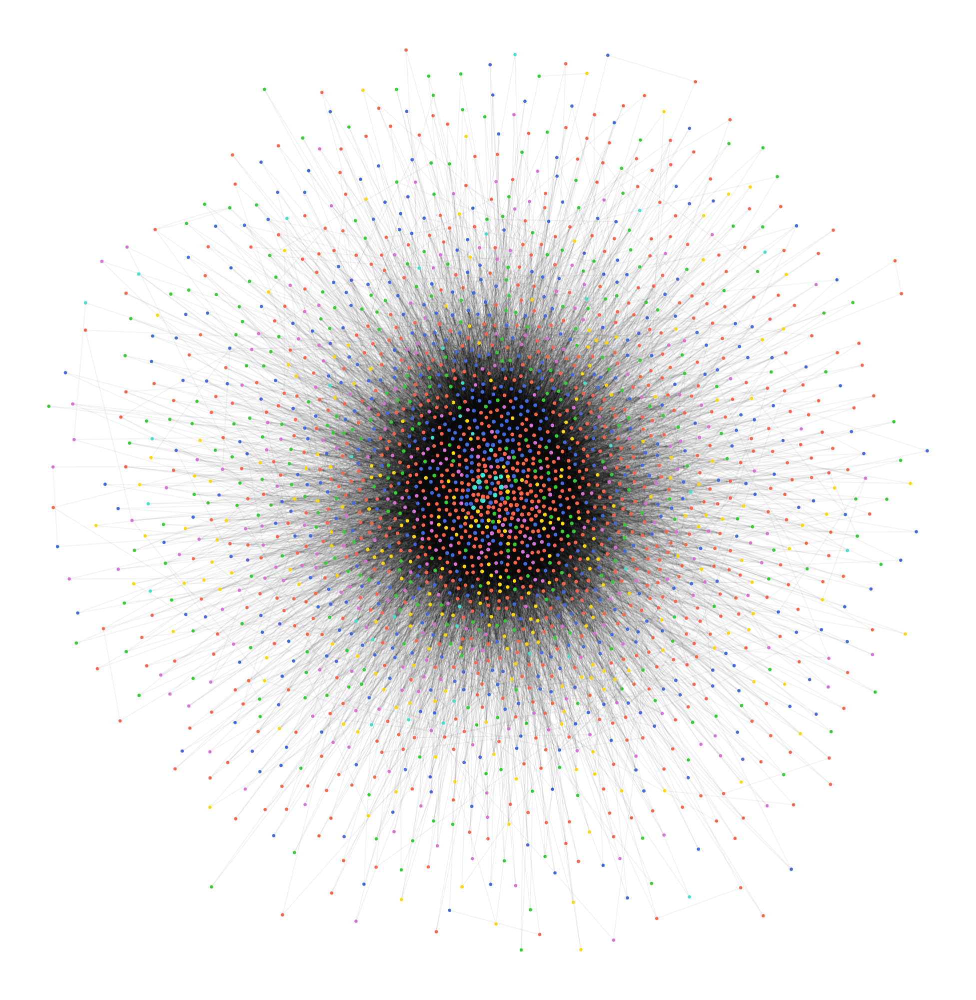

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x3009f6bd0, at 0x14fe75100>

In [24]:

pos = sfdp_layout(g_large)
graph_draw(g_large, pos=pos, output_size=(1000,1000),
           edge_pen_width = 1,
           vertex_size = prop_to_size(g_large.vp.weighted_indeg, mi=3, ma=5),
           #vertex_text = u_large.vp.name, vertex_text_position = -2,
           #vertex_font_size = 20, vertex_text_color='yellow',
           #edge_gradient=[.0, 1., .0, .0, 1.,
           #               .2, 1., .0, .0, 1.,
           #               .3, .3, .3, .3, .2,
           #               .7, .3, .3, .3, .2,
           #               .8, 0, 1, .0, 1,
           #               1., .0, 1, .0, 1],
          vertex_fill_color=g_large.vp.color,#(0,0,1,.5),
          vertex_color=g_large.vp.color,
           edge_color=(0,0,0,0.05)
          #output=f'dvs_proj_graph_r{x}.pdf', fmt='pdf'
          )

#### Zoom in — filter nodes for in-degree > 300

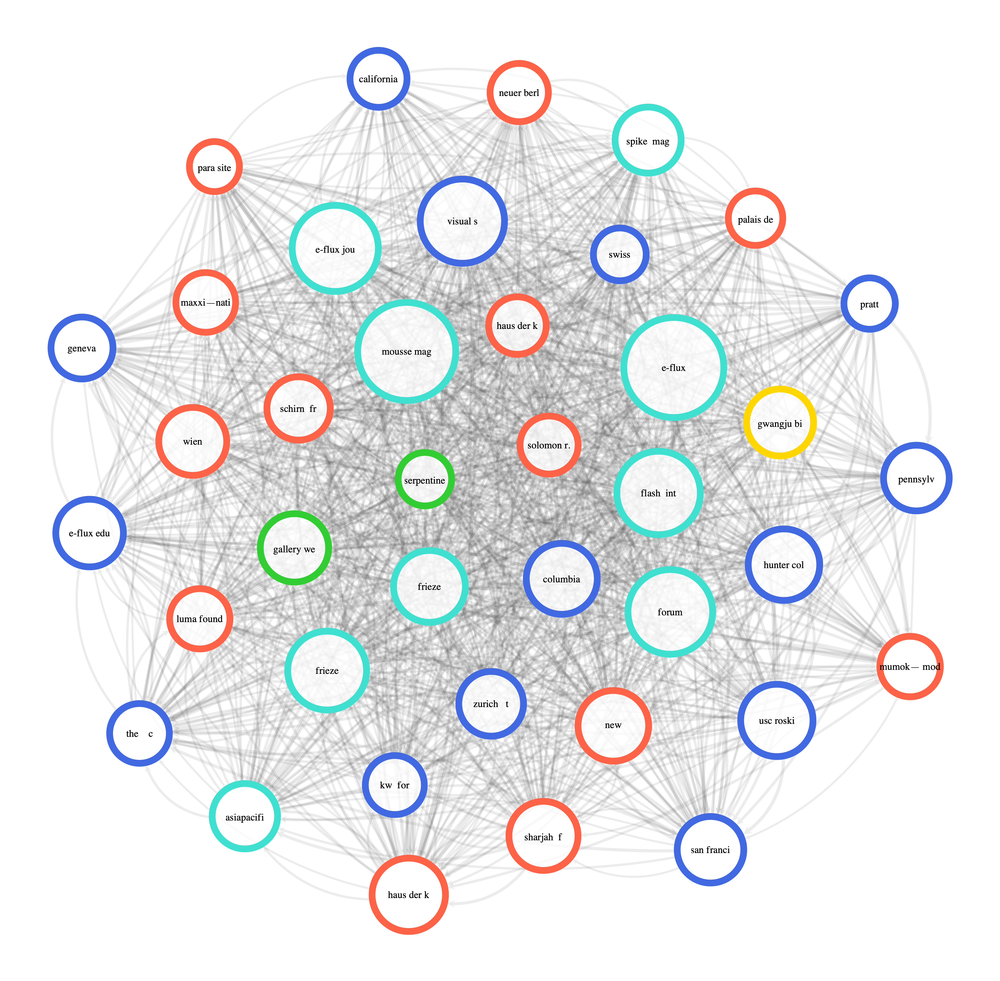

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x15c815eb0, at 0x15f204d40>

In [25]:
#u = GraphView(g_large, efilt = g.ep.count.fa > 5) # edge weight more than five
#       filter nodes with in-degree > 300
u = GraphView(g_large, vfilt = g.vp.weighted_indeg.fa > 300)

u_large = extract_largest_component(u)

pos = sfdp_layout(u_large)

graph_draw(u_large, pos=pos, output_size=(2000,2000),
           edge_pen_width = prop_to_size(u_large.ep.count, mi=4, ma=16),
           vertex_size = prop_to_size(u_large.vp.weighted_indeg, mi=100, ma=200),
           vertex_text = u_large.vp.name, vertex_text_position = -2,
           vertex_font_size = 20, vertex_text_color='black',
           edge_gradient=[.0, .3, .3, .3, .1,
                          .05, .3, .3, .3, .1,
                          .1, .3, .3, .3, .1,
                          .9, .3, .3, .3, .1,
                          .95, .3, .3, .3, .1,
                          1., .3, .3, .3, .1],
          vertex_color=u_large.vp.color,
          vertex_fill_color=(1,1,1,.8),
          #output='dcl_proj_graph3.pdf', fmt='pdf'
          )

#### Zooooom in — filter nodes for in-degree > 700, edge weights = pen_width

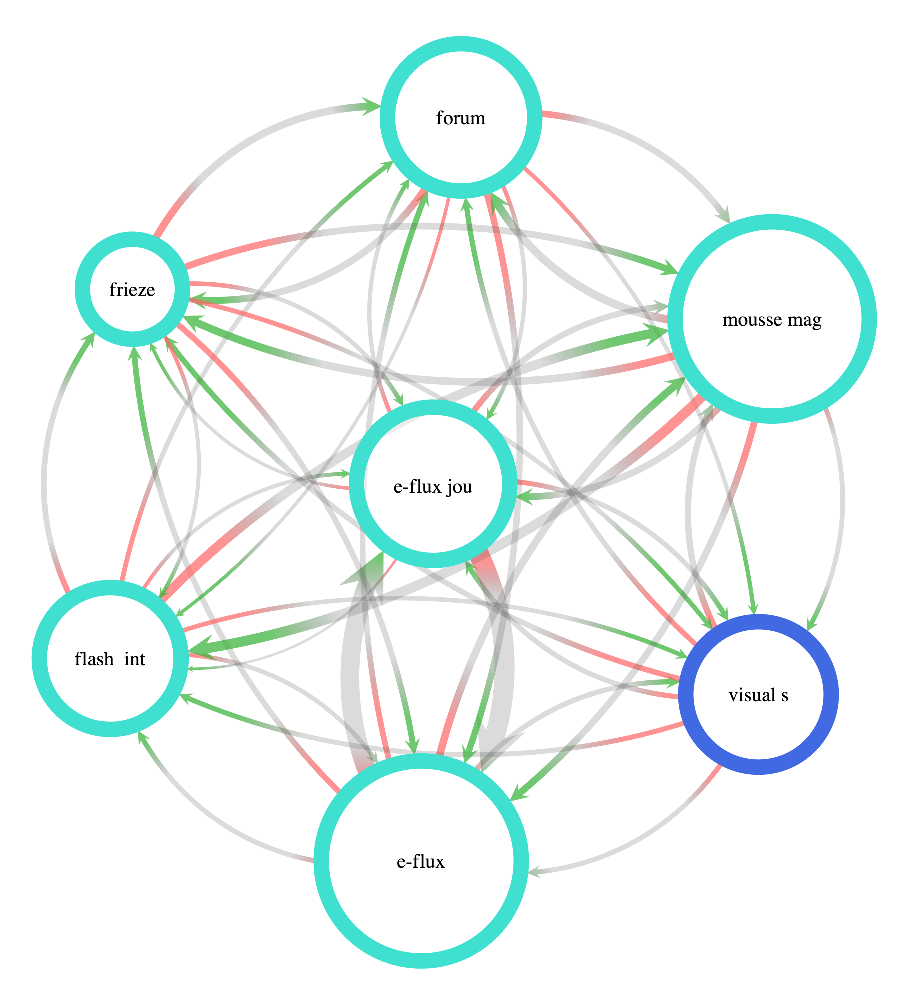

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x15f204a70, at 0x15f2051c0>

In [26]:
#u = GraphView(g_large, efilt = g.ep.count.fa > 5) # edge width more than five
#       filter in-degree > 700
u = GraphView(g_large, vfilt = g.vp.weighted_indeg.fa > 700)

u_large = extract_largest_component(u)

pos = sfdp_layout(u_large)

###pos = arf_layout(u)

#pos = fruchterman_reingold_layout(u, circular=True, grid=False)

#pos = planar_layout(u)

#pos = radial_tree_layout(u, root=list(sorted(u.vertices(), key=lambda v: v.in_degree()))[-1])
#g.add_vertex(len(nodes))
#g.vp.name = g.new_vertex_property('string')



graph_draw(u_large, pos=pos, output_size=(2000,2000),
           edge_pen_width = prop_to_size(u_large.ep.count, mi=5, ma=40),
           vertex_size = prop_to_size(u_large.vp.weighted_indeg, mi=200, ma=400),
           vertex_text = u_large.vp.name, vertex_text_position = -2,
           vertex_font_size = 40, vertex_text_color='black',
           edge_gradient=[.0, 1., .4, .4, .7,
                          .2, 1., .4, .4, .7,
                          .3, .3, .3, .3, .2,
                          .7, .3, .3, .3, .2,
                          .8, .2, .7, .2, .7,
                          1., .2, .7, .2, .7],
          vertex_color=u_large.vp.color,
          vertex_fill_color=(1,1,1,.5),
          #output='dcl_proj_graph3.pdf', fmt='pdf'
          )

#### Nested block model with colors that are the types of the institution — some convergences

Here we can see that 'community detection' works partly interestingly — it detects some blocks of the same type of the institution, for example, a very small block of light-blue journals and a stronger block of blue education institutions or of red museums.

In [27]:
#       apply nested block model
state2 = minimize_nested_blockmodel_dl(g_large)
blocks = state2.get_bstack()[0].vp.b.a
block = g_large.new_vertex_property('int')
block.a = blocks
block

<VertexPropertyMap object with value type 'int32_t', for Graph 0x3009f6bd0, at 0x3009d4ec0>

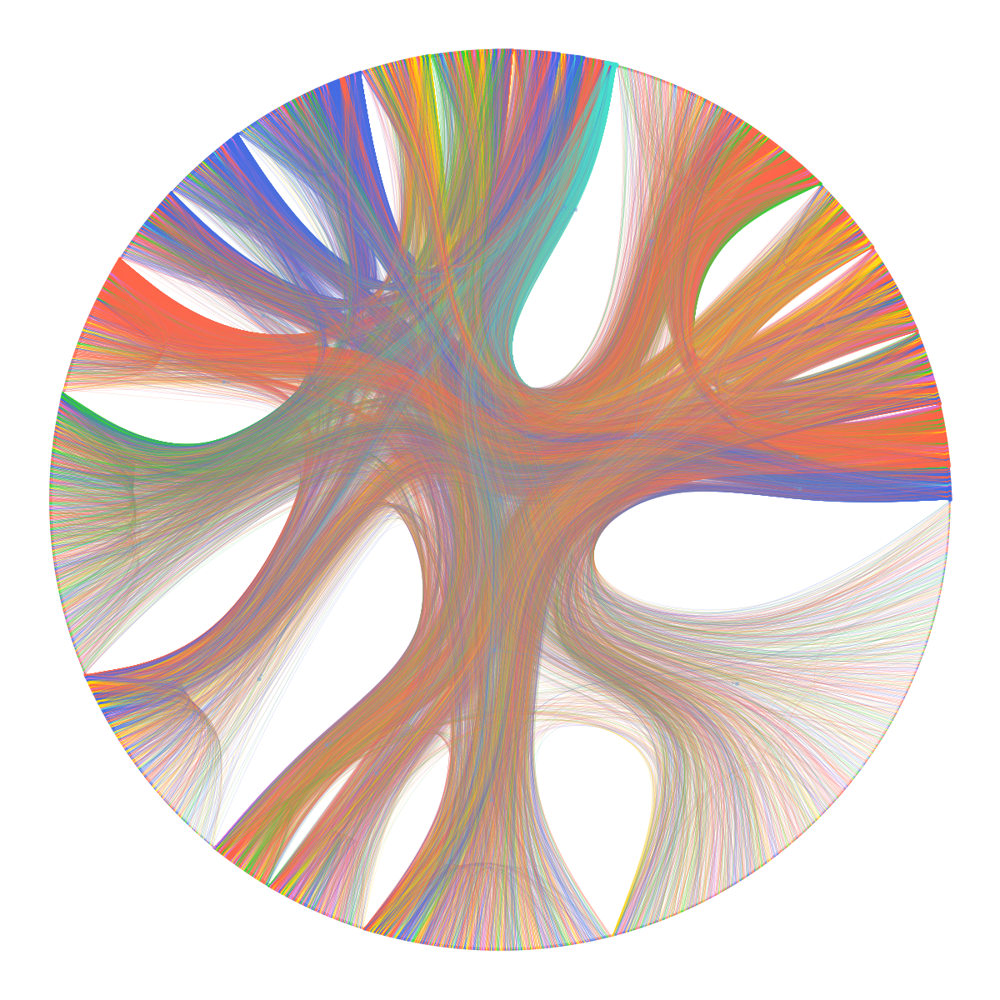

In [28]:
#       visualise
state2.draw(vertex_color=g_large.vp.color, vertex_fill_color=g_large.vp.color);

### In-out degree analysis

However, the most interesting thing in this type of graph was in and out degree. To go deeper into the analysis, we decided to see how different types of institutions vary by the in/out degree ratio. And it was fruitful! Galleries, as expectedly the institutions where artists are just starting their journey appeared to have a low mean i/o ratio, while museum institutions as those established entities where artists generally end their career happened to have the highest results. The corresponding kde plots are below.

<>:34: SyntaxWarning: invalid escape sequence '\m'
<>:34: SyntaxWarning: invalid escape sequence '\m'
/var/folders/7m/rgvk599n03bc70l3bj9p0k840000gp/T/ipykernel_19357/1343905396.py:34: SyntaxWarning: invalid escape sequence '\m'
  f'$\mu$ = {df_nodes[df_nodes.type==type].ioratio.mean():.3f}',
/Users/timonovartmac/anaconda3/envs/gt/lib/python3.12/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/timonovartmac/anaconda3/envs/gt/lib/python3.12/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/timonovartmac/anaconda3/envs/gt/lib/python3.12/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na o

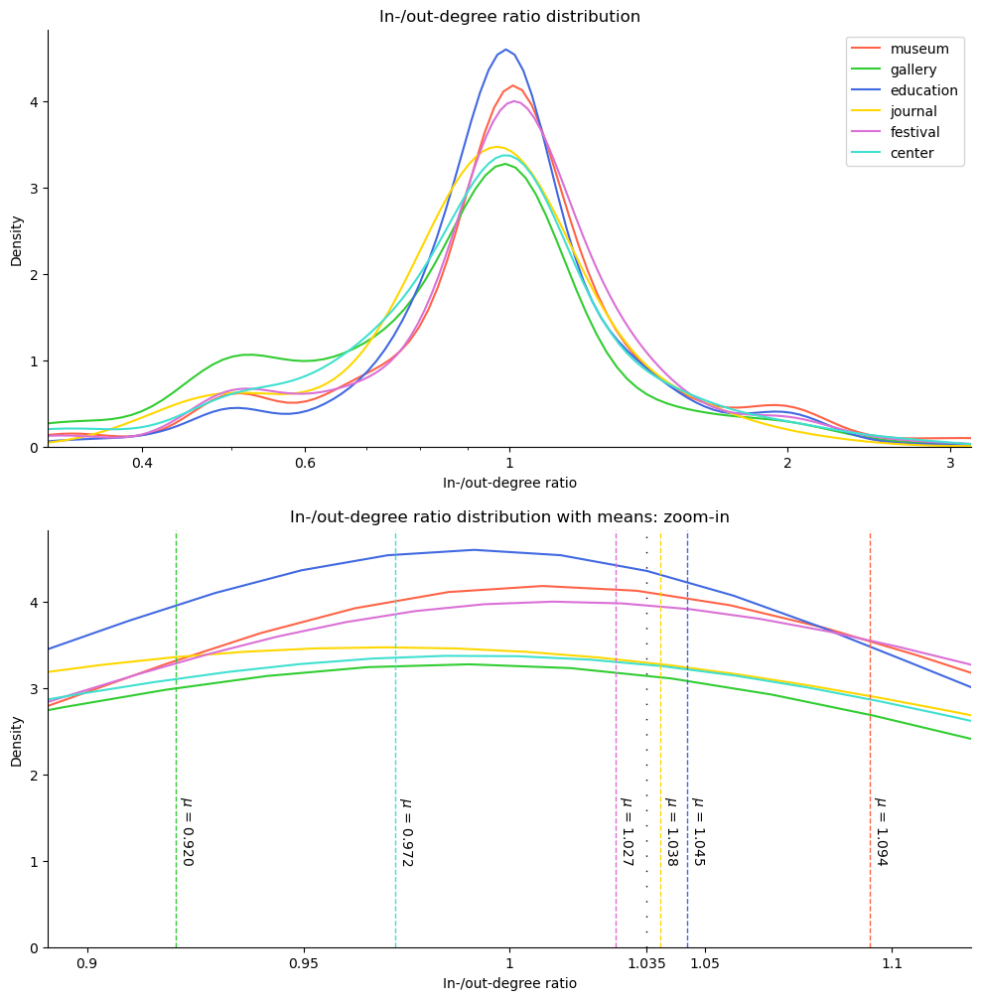

In [29]:
#       for visualisation
color_list = ['tomato', 'limegreen', 'royalblue', 'gold', 'orchid', 'turquoise']

#       add properties values to dataframe with nodes
for name, prop in zip(['indeg', 'weighted_indeg', 'outdeg', 'weighted_outdeg', 'ioratio'],
                      [g.vp.indeg, g.vp.weighted_indeg, g.vp.outdeg, g.vp.weighted_outdeg, g.vp.ioratio]):
    for v in g.vertices():
        df_nodes.loc[g.vp.full_name[v], name] = prop[v]


#       kdeplots for each type (distribution of in/out ratio)        
fig, axes = plt.subplots(2,1,figsize=(12,12))
for lim, ax in zip([.5, .05], axes.reshape(-1)):
    for type,col in zip(['museum', 'gallery', 'education', 'journal', 'festival', 'center'],
                        color_list):
        sns.kdeplot(df_nodes[df_nodes.type==type].ioratio, ax=ax, label=type, log_scale=True, color=col)

    ax.set_xlim(np.logspace(-lim,lim,2))
    ax.set_xlabel('In-/out-degree ratio')
    ax.spines[['right', 'top']].set_visible(False)

axes[0].legend()
axes[0].set_xticks([.4,.6,1,2,3])
axes[0].set_xticklabels([.4,.6,1,2,3])
axes[1].set_xticks([.9,.95,1,1.05,1.1]+[df_nodes.ioratio.mean()])
axes[1].set_xticklabels([.9,.95,1,1.05,1.1]+[f'{df_nodes.ioratio.mean():.3f}'])
axes[0].set_title('In-/out-degree ratio distribution')
axes[1].set_title('In-/out-degree ratio distribution with means: zoom-in')

for type,col in zip(['museum', 'gallery', 'education', 'journal', 'festival', 'center'],
                        color_list):
    axes.reshape(-1)[1].axvline(x=df_nodes[df_nodes.type==type].ioratio.mean(), color=col, lw=1, ls='--')
    axes[1].text(df_nodes[df_nodes.type==type].ioratio.mean()+.0005, 1,
                 f'$\mu$ = {df_nodes[df_nodes.type==type].ioratio.mean():.3f}',
                color='black', rotation=270)
axes.reshape(-1)[1].axvline(x=df_nodes.ioratio.mean(), color='black', lw=1, ls=(0,(1,10)))

To check this ratio for any effects, we decided to implement a very simplistic test — we scraped the length of the wikipedia page for the institutions and decided to see at the correlations between the ratio and the page length with the latter being the proxy for measuring success. It turned out that there is evidentely no correlation, and so we decided to abandon this branch of our research. Although threr is a little data for wiki — slightly more than 25 percent, the result seems still credible (meaning the absence of result:)).

##### code for scrapping

In [30]:
'''

import wikipediaapi

dfff = pd.read_csv('df_nodes.csv')
dfff = dfff[dfff.categorised == True].set_index('subtitle')

lang_dict = {'British': 'en'}

wiki_dict = {}
for lang in set(lang_dict.values()):
    wiki_dict[lang] = wikipediaapi.Wikipedia('Artists_scrapper (timonov_artem@student.ceu.edu)',
                                             lang, extract_format=wikipediaapi.ExtractFormat.HTML)

start_time = time.time()
count_errors_en = 0
counter = 0
for artist in dfff.index:
    if (counter % 10 == 0) and counter < 100:
        print(f'{counter} of {len(dfff)}')
    if counter % 1000 == 0:
        print(f'{counter} of {len(dfff)}')
    counter += 1
    page = wiki_dict['en'].page(artist.replace(' ','_'))
    try:
        if (page.exists() == True):
            dfff.loc[artist, 'wiki_length_en'] = len(page.text)
        else:
            dfff.loc[artist, 'wiki_length_en'] = 0
    except:
        dfff.loc[artist, 'wiki_length_en'] = 0
        count_errors_en += 1
time_spent_en = time.time() - start_time
print(f'For artists there was {count_errors_en} errors, it took {time_spent_en} seconds.')

dfff.to_csv('dfff.csv')

''';

#### Continue with in/out degree

Text(0.5, 1.0, 'Wikipedia page length histogram for institutions')

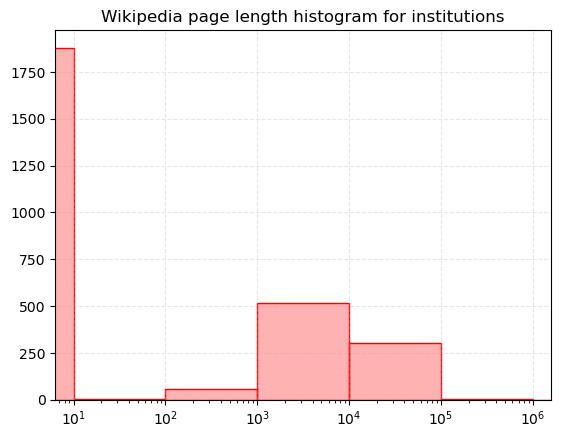

In [31]:
#       get wikipedia length data and plot a historgram
dfff = pd.read_csv('data/dfff.csv').set_index('subtitle')
for name in dfff.index:
    df_nodes.loc[name, 'wiki'] = dfff.loc[name, 'wiki_length_en']
fig, ax = plt.subplots()
df_nodes.wiki.hist(ax=ax, bins=[0] + list(np.logspace(1,7,7)),
                  color=(1,0,0,.3), ec=(1,0,0,1))
ax.set_xscale('log')
#ax.set_yscale('log')
ax.set_xlim(10**(0.8), 10**(6.2))
ax.grid(ls='--', alpha=.3)
ax.set_title('Wikipedia page length histogram for institutions')



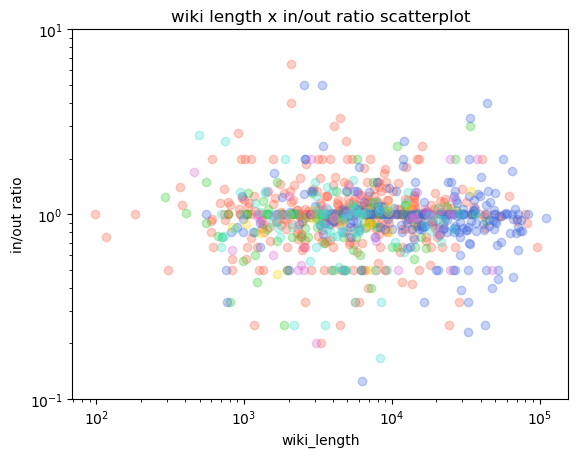

In [32]:
#       plot wiki length x in/out ratio
df_nodes[df_nodes.wiki>0]
fig, ax = plt.subplots()
for type, color in zip(['museum', 'gallery', 'education', 'journal', 'festival', 'center'], color_list):
    ax.scatter(df_nodes[(df_nodes.wiki>0) & (df_nodes.type==type)].wiki,
               df_nodes[(df_nodes.wiki>0) & (df_nodes.type==type)].ioratio,
               c=color, alpha=.3)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('wiki_length')
ax.set_ylabel('in/out ratio')
ax.set_title('wiki length x in/out ratio scatterplot')
ax.set_ylim(.1,10);

### Bonus — Individual trajectory visualisations

#### Data preparation

In [33]:
#       select name of the artist to see the trajectory (his exhibition is currently in Secession)
traj_name='Zach Blas'
#       find his index
for i, artist in enumerate(arti):
    if artist['name'] == traj_name:
        traj_i = i
        break
#       get all institutions of the artist
ann_list = [x for x in arti[traj_i]['announcements'] if filt_all(x['subtitle'])]
#       sort them by date
ann_list.sort(key = lambda x: datetime.strptime(x['announcement_date'], '%B %d, %Y'))
#       create edges from each successive pair
traj_ZB = [(ann_list[i]['subtitle'], ann_list[i+1]['subtitle']) for i in range(len(ann_list)-1)]
#       get nodes list
nodes_ZB = [ann_list[i]['subtitle'] for i in range(len(ann_list))]
#       filter out staying in the same institution
traj_ZB = [x for x in traj_ZB if x[0] != x[1]]

In [34]:
#       edge property TRUE if in ZB's traj
g_large.ep.traj_ZB = g_large.new_edge_property('int')
for e in g_large.edges():
    g_large.ep.traj_ZB[e] = (nodes[int(e.source())],
                           nodes[int(e.target())]) in traj_ZB
#       node property TRUE if visited by ZB
g_large.vp.nodes_ZB = g_large.new_vertex_property('double')
for v in g_large.vertices():
    g_large.vp.nodes_ZB[v] = [i for i, e in enumerate(nodes_ZB) if e == nodes[int(v)]][-1]+1 if nodes[int(v)] in nodes_ZB else 0

In [35]:
#       color black if edge by ZB, white otherwise
g_large.ep.color = g_large.new_edge_property('string')
for e in g_large.edges():
    if g_large.ep.traj_ZB[e] == 1:
        g_large.ep.color[e] ='black'
    else:
        g_large.ep.color[e] ='white'

#### Whole network

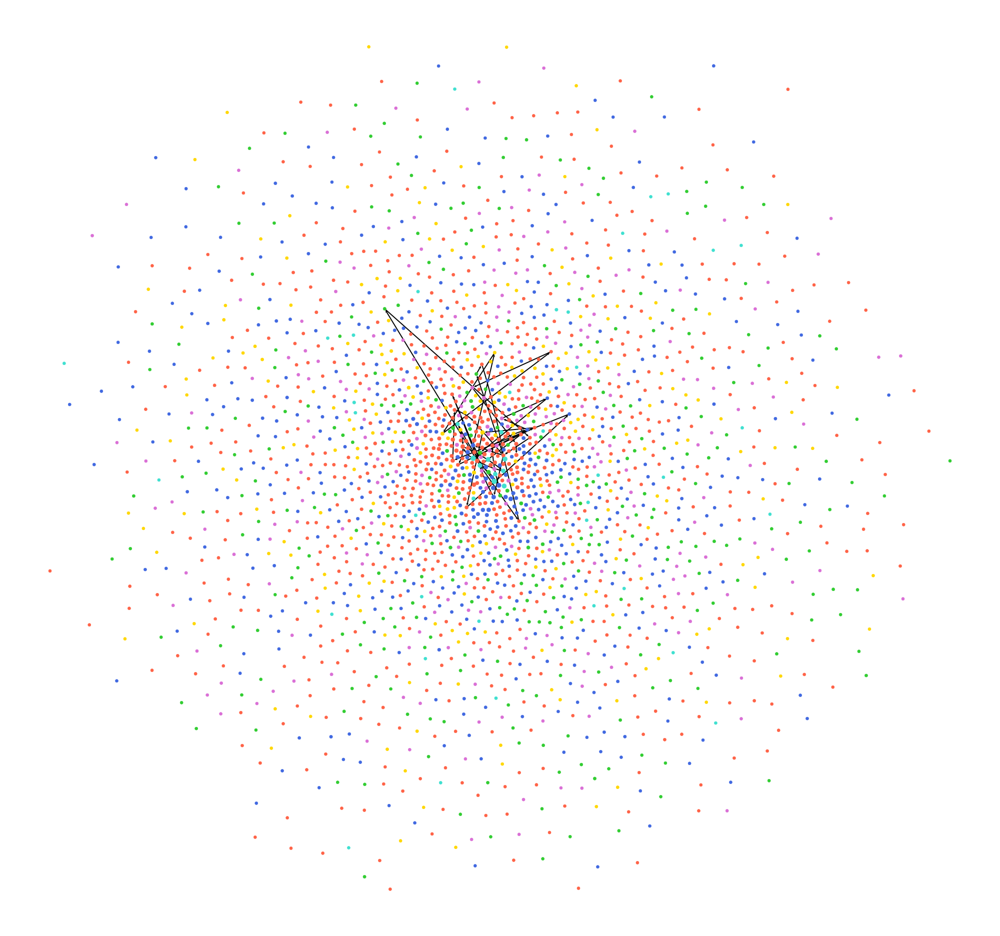

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x3009f6bd0, at 0x300531640>

In [36]:
pos = sfdp_layout(g_large)

graph_draw(g_large, pos=pos, output_size=(1000,1000),
           edge_pen_width = 1,
           eorder=g_large.ep.traj_ZB,
           vertex_size = prop_to_size(g_large.vp.weighted_indeg, mi=3, ma=5),
           #vertex_text = u_large.vp.name, vertex_text_position = -2,
           #vertex_font_size = 20, vertex_text_color='yellow',
           #edge_gradient=[.0, 1., .0, .0, 1.,
           #               .2, 1., .0, .0, 1.,
           #               .3, .3, .3, .3, .2,
           #               .7, .3, .3, .3, .2,
           #               .8, 0, 1, .0, 1,
           #               1., .0, 1, .0, 1],
          vertex_fill_color=g_large.vp.color,#(0,0,1,.5),
          vertex_color=g_large.vp.color,
           edge_color= g_large.ep.color
        
          #output=f'dvs_proj_graph_r{x}.pdf', fmt='pdf'
          )

##### Zoom in — filtered nodes of the trajectory. nodecolor, nodeorder =  order of artist's movement

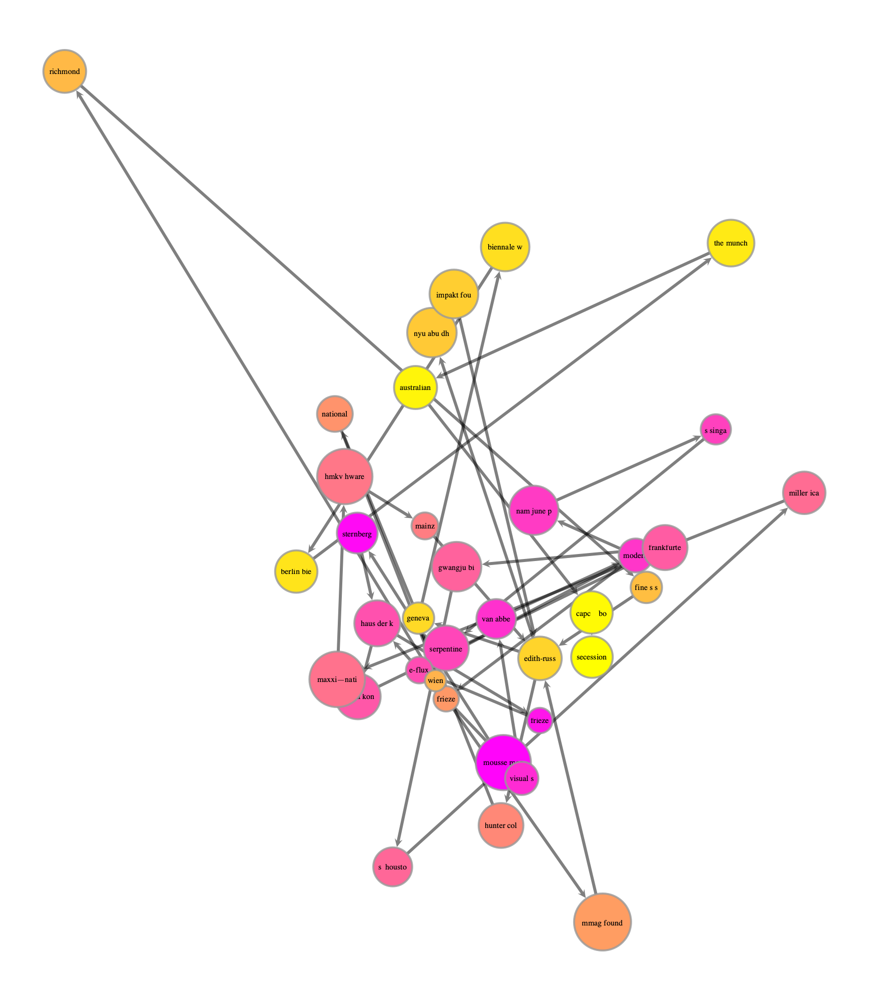

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x300443560, at 0x300440b60>

In [37]:
g_filt = GraphView(g_large,vfilt=g_large.vp.nodes_ZB.fa>0,efilt=g_large.ep.traj_ZB.fa>0)
graph_draw(g_filt, pos=pos, output_size=(1000,1000),
           edge_pen_width = 3,
           eorder=g_large.ep.traj_ZB,
           vertex_size = prop_to_size(g_large.vp.weighted_indeg, mi=20, ma=20),
           vertex_text = u_large.vp.name, vertex_text_position = -1,
           vertex_font_size = 8, vertex_text_color='black',
           #edge_gradient=[.0, 1., .0, .0, 1.,
           #               .2, 1., .0, .0, 1.,
           #               .3, .3, .3, .3, .2,
           #               .7, .3, .3, .3, .2,
           #               .8, 0, 1, .0, 1,
           #               1., .0, 1, .0, 1],
          vertex_fill_color=g_large.vp.nodes_ZB,
           vcmap = matplotlib.cm.spring,#g_large.vp.color,#(0,0,1,.5),
           vorder=g_large.vp.nodes_ZB,
          #vertex_color=g_large.vp.color,
           edge_color= (0,0,0,.5),
           
        
          #output=f'dvs_proj_graph_r{x}.pdf', fmt='pdf'
          )

##### Reshuffle — filtered nodes of the trajectory, new layout, color=institution type

In [38]:
g_ZB = GraphView(g_large, efilt = g_large.ep.traj_ZB.fa > 0,
                vfilt = g_large.vp.nodes_ZB.fa>0)
pos = sfdp_layout(g_ZB )


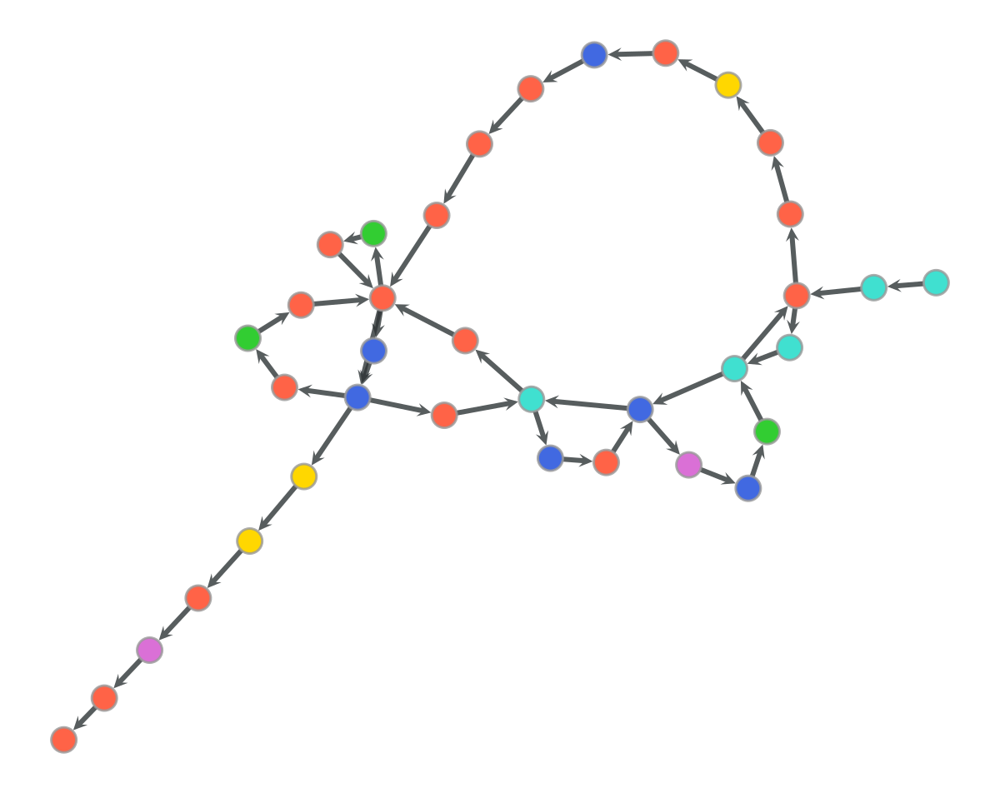

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x307c07590, at 0x307bc8590>

In [39]:
graph_draw(g_ZB, pos=pos, vertex_fill_color=g_large.vp.color, vertex_size=15, edge_pen_width=3,)
        #    vertex_text_color='black'
          

##### Reshuffle — filtered nodes of the trajectory, new layout, color=trajectory, size=nothing (fit text)

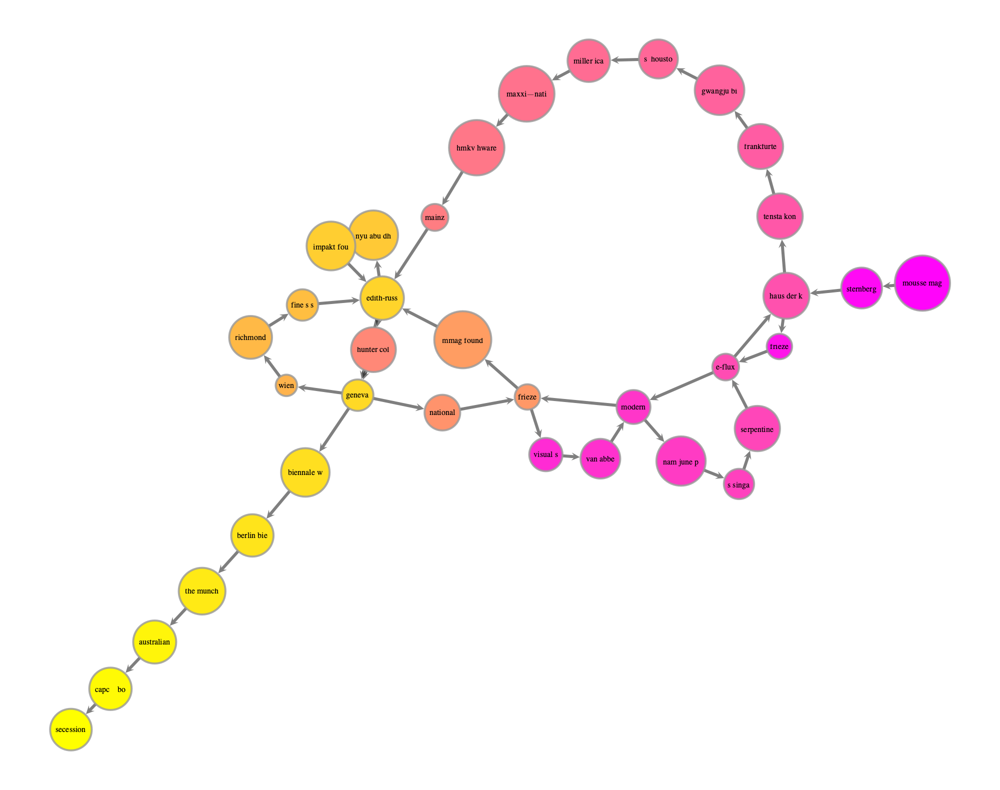

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x32ad1daf0, at 0x30031a390>

In [40]:
g_filt = GraphView(g_large,vfilt=g_large.vp.nodes_ZB.fa>0,efilt=g_large.ep.traj_ZB.fa>0)
graph_draw(g_filt, pos=pos, output_size=(1000,1000),
           edge_pen_width = 3,
           eorder=g_large.ep.traj_ZB,
           vertex_size = prop_to_size(g_large.vp.weighted_indeg, mi=20, ma=20),
           vertex_text = u_large.vp.name, vertex_text_position = -1,
           vertex_font_size = 8, vertex_text_color='black',
           #edge_gradient=[.0, 1., .0, .0, 1.,
           #               .2, 1., .0, .0, 1.,
           #               .3, .3, .3, .3, .2,
           #               .7, .3, .3, .3, .2,
           #               .8, 0, 1, .0, 1,
           #               1., .0, 1, .0, 1],
          vertex_fill_color=g_large.vp.nodes_ZB,
           vcmap = matplotlib.cm.spring,#g_large.vp.color,#(0,0,1,.5),
           vorder=g_large.vp.nodes_ZB,
          #vertex_color=g_large.vp.color,
           edge_color= (0,0,0,.5),
           
        
          #output=f'dvs_proj_graph_r{x}.pdf', fmt='pdf'
          )